# Example 1: Using Jupyter, MIBI dataset

If you have a dataset can be processed on your own computer, using Jupyter environment for data analysis and visualization is pretty convenient.

## Data description

In this example I use MIBI dataset from this article:

[A Structured Tumor-Immune Microenvironment in Triple Negative Breast Cancer Revealed by Multiplexed Ion Beam Imaging](https://doi.org/10.1016/j.cell.2018.08.039)

**Download the data** for following analysis: [Link](https://uofmacau-my.sharepoint.com/:u:/g/personal/yb97643_umac_mo/ET7-chqWIc9EqSEtY-foQ7IBURusGw9hlTSBC3xD_bNdgw?download=1)

For origin data, follow their instruction in the article to request it. The processed data is placed at their [lab's page](https://www.angelolab.com/mibi-data). The data contains 41 patients, one ROI per patient.


The following example runs on an iMac 8-cores/40G RAM.

In [1]:
import spatialtis as st
import spatialtis.plotting as sp
from spatialtis import CONFIG

First let's read the data, I have already processed their data into anndata object.

Because some of the background region are also marked as a cell in their mask images, we can filter out most of it based on area size.

In [2]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [3]:
import anndata as ad
data = ad.read_h5ad("../data/mibi_data.h5ad")
data = data[data.obs['area'] < 1000].copy()
data

AnnData object with n_obs × n_vars = 181376 × 39
    obs: 'Patient', 'area', 'cell_shape', 'centroid', 'eccentricity', 'cell_type'
    var: 'markers'

In [4]:
CONFIG.EXP_OBS = ['Patient']
CONFIG.CELL_TYPE_KEY = "cell_type"
CONFIG.MARKER_KEY = "markers"

CONFIG

## Visualization of ROI

If you have cell shape data, you can visualiza certain ROI, select the cells to highlight

Click the legend to mute certain cell type

In [5]:
sp.cell_map(data, {'Patient':'Patient 1'}, size=(500, 800))

Visualization of marker expression in an ROI is also avaialble.

In [6]:
sp.expression_map(data, {'Patient':'Patient 1'}, order=['CD4', 'CD8', 'CD20'], size=(650, 600))

## Basic Statistic of spatial single cell data

- Cell components
- Cell density
- Cell morphology (eg. area, eccentricity...)
- Cell co-occurrence

### Cell components

This is to count the fraction of each cell type in different group

In [7]:
st.cell_components(data)

In [8]:
immune_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono']
sp.cell_components(data, ['Patient'], 
                   size=(400, 1000), 
                   selected_types=immune_cells, 
                   sort_type='Macrophages',
                   title="Immune Cells' Components",
                   xaxis_title="Patients", 
                   yaxis_title="Percentage of cells(%)",
                  )

### Cell density

This is to measure the density of cell in each ROI

In [9]:
st.cell_density(data, ratio=0.001)

The Keratin-positive tumor is obviously much denser than other cell

In [10]:
selected_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono', 
               'Keratin-positive tumor', 'Tumor','Endothelial', 'Mesenchymal-like']
sp.cell_density(data,
                selected_types=selected_cells,
                size=(350, 500),
                title="Cell density in 41 TNBC patinets", 
                yaxis_title="Number of cells/mm^2",
                palette=['#fdae61',]
               )

### Cell morphology

This is to measure the area or the eccentricity of cells, the default is to use eccentricity. The value of eccentricity get more close to 1 means the shape of the cell is more close to a circle.

In [11]:
st.cell_morphology(data)

In [12]:
immune_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono']
sp.cell_morphology(data, 
                   selected_types=immune_cells, 
                   size=(300, 400), 
                   title="Eccentricity of immune cells", 
                   yaxis_title="eccentricity",
                   palette=['#abdda4',]
                  )

### Cell co-occurrence

This is to measure the likelihood of two type of cells occur in the same ROI

In [13]:
st.cell_co_occurrence(data)

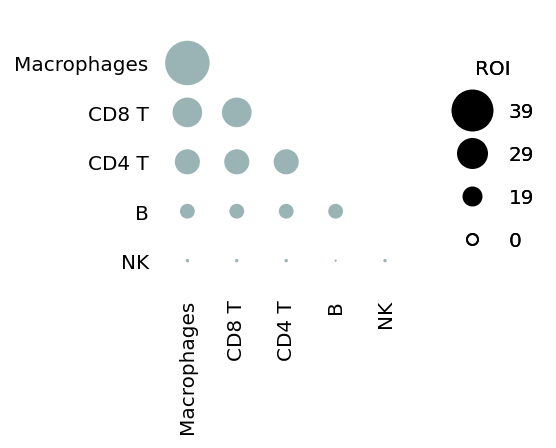

In [14]:
immune_cells = ['Macrophages', 'CD8 T', 'CD4 T', 'B', 'NK']
sp.cell_co_occurrence(data, ['Patient'], selected_types=immune_cells)

## Spatial analysis

- Spatial distribution
- Spatial heterogeneity
- Cell-cell interaction (Neighborhood analysis)
- Markers co-expression (Spatial enrichment analysis)
- Hotspot detection
- Spatial community detection
- Neighbor dependent markers

### Spatial distribution

The pattern of spatial distribution is `Random`, `Cluster`, `Regular`.

In [15]:
st.spatial_distribution(data)

Finding distribution pattern ██████████ 100% 00:00|00:08


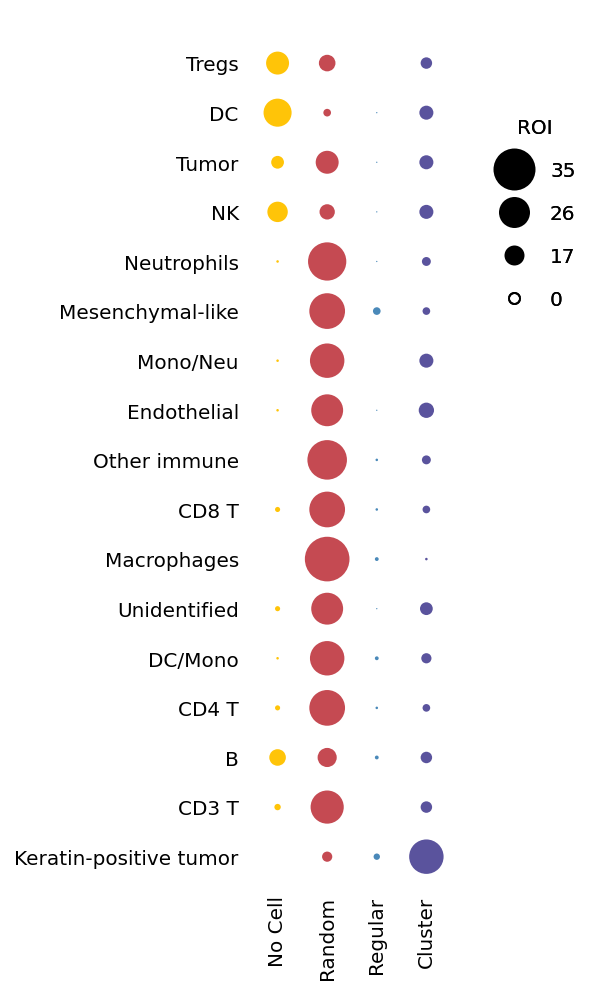

In [16]:
sp.spatial_distribution(data, use="dot")

### Spatial Heterogeneity

SpatialTis implemented 3 entropy based methods to quantify the heterogeneity

- Shannon entropy
- Altieri entropy
- Leibovici entropy

Check [spatialentropy](https://github.com/Mr-Milk/SpatialEntropy) if you are interested.

In [18]:
st.spatial_heterogeneity(data, method="altieri", cut=10)

Calculating heterogeneity ██████████ 100% 00:00|01:05


In [19]:
sp.spatial_heterogeneity(data, size=(500, 1000))

### Finding cell neighbors

Intiate a `Neighbors` instance to find neighbors for each cells.

This MIBI dataset has cell shape data, we can search using default setting. For data resolved cell as point, pass `geom="point"`

In [20]:
n = st.Neighbors(data)

SpatialTis search the neighbors of a cell by enlarge the cell

`scale=1.5` will scale the cell at 1.5 fold (shape data)

`expand=5` will expand the cell by 5 unit (shape data, point data)

In [21]:
n.find_neighbors(expand=5)

Get cells' bbox ██████████ 100% 00:00|00:08

[green]Find neighbors:  57%|█████▊    | 23/40 [00:00<00:00, 108.41it/s]

[green]Find neighbors: 100%|██████████| 40/40 [00:00<00:00, 138.96it/s]


A spatialtis.Neighbors instance, neighbor computed: True

You can also visualize the cell neighbors in any ROI

In [22]:
sp.cell_neighbors(data, {'Patient': 'Patient 1'})

### Neighborhood analysis

To profile the cell-cell relationship, neighborhood analysis tells you whether two type of cells are **association** or **avoidance**. 

Association means they are likely to occur at one's neighborhood

Avoidance means they tend to avoid to see one another

Neither means the relationship is random

Check [neighborhood_analysis](https://github.com/Mr-Milk/neighborhood_analysis) if you are interested.

<div class="alert alert-block alert-info">
Notice something is different in the parameter of the following analysis function, we pass in (n) a spatialtis.Neighbor instance instead of (data) a anndata object.
</div>

In [23]:
st.neighborhood_analysis(n, resample=999)

Neighborhood analysis ██████████ 100% 00:00|00:07


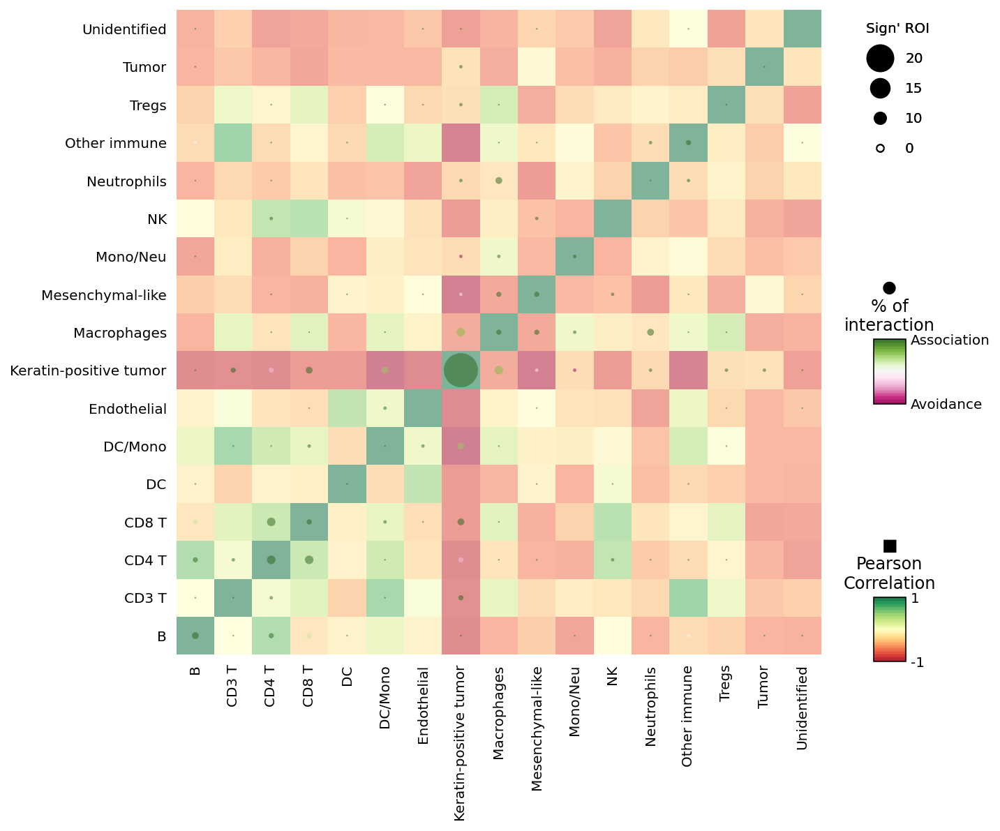

In [24]:
sp.neighborhood_analysis(data)

### Spatial enrichment analysis

Profiling markers co-expression

In [25]:
st.spatial_enrichment_analysis(n, threshold=0.1, resample=500)

Spatial enrichment analysis ██████████ 100% 00:00|05:10


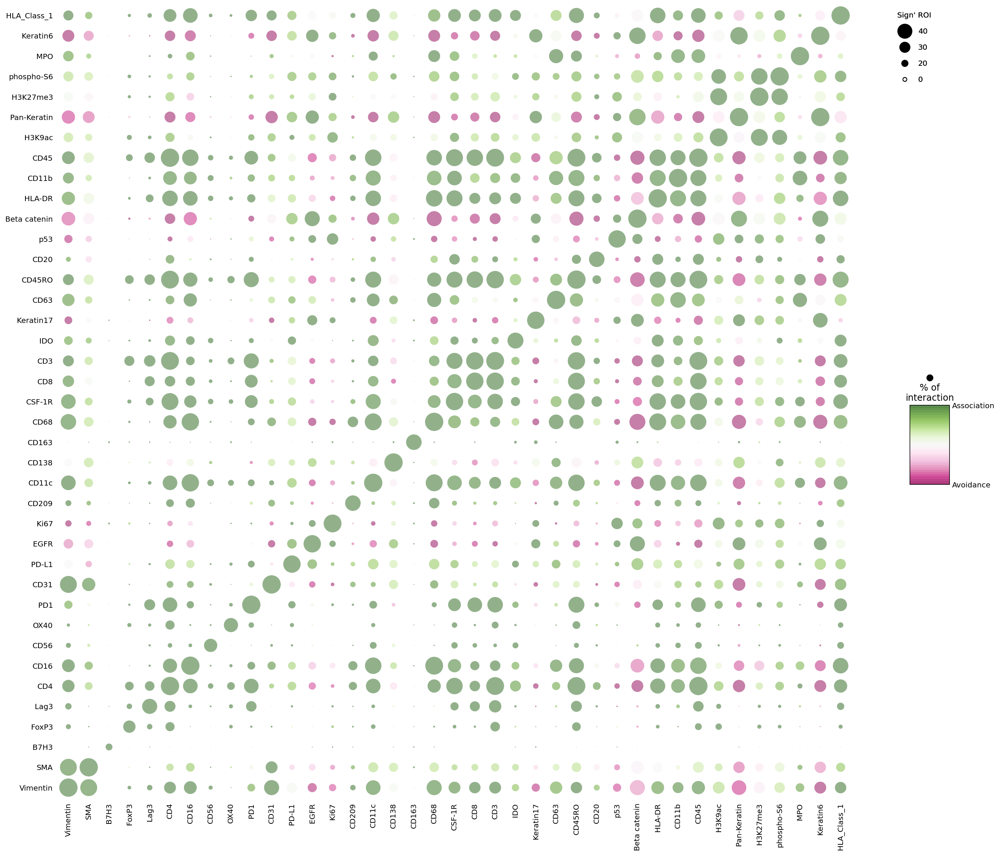

In [26]:
sp.spatial_enrichment_analysis(data)

### Cell communities detection

Leiden algorithm for communities detection

In [27]:
n.export_neighbors()
n.read_neighbors()

A spatialtis.Neighbors instance, neighbor computed: True

In [28]:
st.communities(n)

Communities detection ██████████ 100% 00:00|00:00


In [29]:
sp.cell_communities(data, {'Patient': 'Patient 1'})

### Neighbor cells dependent markers

<div class="alert alert-block alert-danger">
    
When processing your own data, you should use higher std threshold, i set a low value here only for illustration
     
</div>

In [30]:
st.NCD_markers(n, expression_std_cutoff=1.0)

Fitting model              0% ?|00:00

/Users/milk/anaconda3/envs/spatialtis/lib/python3.8/site-packages/xgboost/data.py:94: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


Fitting model ██████████ 100% 00:00|00:12


The sankey plot is interpretated as: 

The **Cell 1**'s **Marker** is affected by the occurrence of **Cell 2** at it's neighbors

In [31]:
sp.NCD_markers(data, score=0.4)

### Neighbor markers dependent markers

In [32]:
st.NMD_markers(n, expression_std_cutoff=1.0)

Fitting model              0% ?|00:00

/Users/milk/anaconda3/envs/spatialtis/lib/python3.8/site-packages/xgboost/data.py:94: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


Fitting model ██████████ 100% 00:00|01:51


Always remember to save your results by writing to the anndata file, otherwise it only store in the RAM

In [33]:
#data.write(data)